In [3]:
pip install opencv-python


  Using cached opencv_python-4.11.0.86-cp37-abi3-win_amd64.whl.metadata (20 kB)
Using cached opencv_python-4.11.0.86-cp37-abi3-win_amd64.whl (39.5 MB)


In [4]:
import tensorflow as tf
import cv2

In [16]:
pip install scipy

   ---------------------------------------- 0.0/41.3 MB ? eta -:--:--
   ---------------------------------------- 0.3/41.3 MB ? eta -:--:--
   ---------------------------------------- 0.3/41.3 MB ? eta -:--:--
    --------------------------------------- 0.5/41.3 MB 1.1 MB/s eta 0:00:37
    --------------------------------------- 0.8/41.3 MB 985.5 kB/s eta 0:00:42
   - -------------------------------------- 1.0/41.3 MB 949.8 kB/s eta 0:00:43
   - -------------------------------------- 1.0/41.3 MB 949.8 kB/s eta 0:00:43
   - -------------------------------------- 1.0/41.3 MB 949.8 kB/s eta 0:00:43
   - -------------------------------------- 1.3/41.3 MB 771.0 kB/s eta 0:00:52
   - -------------------------------------- 1.6/41.3 MB 798.7 kB/s eta 0:00:50
   - -------------------------------------- 1.8/41.3 MB 811.6 kB/s eta 0:00:49
   -- ------------------------------------- 2.1/41.3 MB 869.7 kB/s eta 0:00:46
   -- ------------------------------------- 2.1/41.3 MB 869.7 kB/s eta 0:00:46
  

In [1]:
import os
import matplotlib.pyplot as plt
import numpy as np
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.preprocessing import image
from tensorflow.keras.optimizers import RMSprop
from tensorflow.keras.callbacks import EarlyStopping

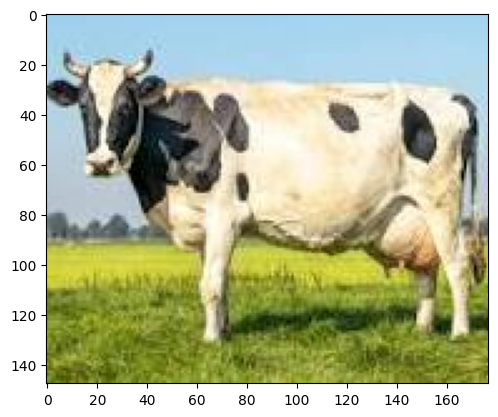

In [2]:

# Load and preview image
img = image.load_img("C:/Users/Dell/Desktop/ML2/basedata2/train2/cow/1.jpeg")
plt.imshow(img)

In [5]:
print(cv2.imread("C:/Users/Dell/Desktop/ML2/basedata2/train2/cow/1.jpeg").shape)

(148, 177, 3)


In [6]:

# Enhanced Data Augmentation for training
train = ImageDataGenerator(
    rescale=1./255,
    rotation_range=30,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

validation = ImageDataGenerator(rescale=1./255)

In [7]:
# Load datasets
train_dataset = train.flow_from_directory("C:/Users/Dell/Desktop/ML2/basedata2/train2/",
                                          target_size=(200, 200),
                                          batch_size=3,
                                          class_mode="binary")

validation_dataset = validation.flow_from_directory("C:/Users/Dell/Desktop/ML2/basedata2/val2/",
                                                    target_size=(200, 200),
                                                    batch_size=3,
                                                    class_mode="binary")

Found 708 images belonging to 2 classes.
Found 389 images belonging to 2 classes.


In [8]:
train_dataset.class_indices

{'cow': 0, 'har': 1}

In [9]:
train_dataset.classes

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,

In [10]:
# Improved CNN Model
model = tf.keras.models.Sequential([
    tf.keras.layers.Conv2D(16, (3, 3), strides=(1, 1), input_shape=(200, 200, 3)),
    tf.keras.layers.LeakyReLU(alpha=0.1),
    tf.keras.layers.AveragePooling2D(2, 2),

    tf.keras.layers.Conv2D(32, (3, 3), strides=(1, 1)),
    tf.keras.layers.LeakyReLU(alpha=0.1),
    tf.keras.layers.AveragePooling2D(2, 2),

    tf.keras.layers.Conv2D(64, (3, 3), strides=(1, 1)),
    tf.keras.layers.LeakyReLU(alpha=0.1),
    tf.keras.layers.AveragePooling2D(2, 2),

    tf.keras.layers.Conv2D(128, (3, 3), strides=(1, 1)),
    tf.keras.layers.LeakyReLU(alpha=0.1),
    tf.keras.layers.AveragePooling2D(2, 2),

    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(512),
    tf.keras.layers.LeakyReLU(alpha=0.1),
    tf.keras.layers.Dropout(0.5),  # Dropout layer to prevent overfitting
    tf.keras.layers.Dense(1, activation="sigmoid")  # Binary classification
])


C:\Users\Dell\.conda\envs\py310_env\lib\site-packages\keras\src\layers\convolutional\base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)
C:\Users\Dell\.conda\envs\py310_env\lib\site-packages\keras\src\layers\activations\leaky_relu.py:41: UserWarning: Argument `alpha` is deprecated. Use `negative_slope` instead.
  warnings.warn(


In [11]:
model.compile(loss="binary_crossentropy",
              optimizer=RMSprop(learning_rate=0.001),
              metrics=["accuracy"])

In [12]:
# EarlyStopping to prevent overfitting
early_stop = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

# Train the model
model_fit = model.fit(train_dataset,
                      steps_per_epoch=3,
                      epochs=30,
                      validation_data=validation_dataset,
                      callbacks=[early_stop])

C:\Users\Dell\.conda\envs\py310_env\lib\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/30
3/3 ━━━━━━━━━━━━━━━━━━━━ 0s 174ms/step - accuracy: 0.5556 - loss: 1.2844

C:\Users\Dell\.conda\envs\py310_env\lib\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


3/3 ━━━━━━━━━━━━━━━━━━━━ 7s 3s/step - accuracy: 0.5833 - loss: 1.6333 - val_accuracy: 0.7147 - val_loss: 0.5944
Epoch 2/30
3/3 ━━━━━━━━━━━━━━━━━━━━ 5s 2s/step - accuracy: 0.7500 - loss: 0.9854 - val_accuracy: 0.7147 - val_loss: 0.6140
Epoch 3/30
3/3 ━━━━━━━━━━━━━━━━━━━━ 5s 2s/step - accuracy: 0.6111 - loss: 0.6908 - val_accuracy: 0.3290 - val_loss: 0.7025
Epoch 4/30
3/3 ━━━━━━━━━━━━━━━━━━━━ 5s 2s/step - accuracy: 0.4306 - loss: 0.7171 - val_accuracy: 0.7121 - val_loss: 0.6755
Epoch 5/30
3/3 ━━━━━━━━━━━━━━━━━━━━ 5s 3s/step - accuracy: 0.4861 - loss: 0.7026 - val_accuracy: 0.7147 - val_loss: 0.6188
Epoch 6/30
3/3 ━━━━━━━━━━━━━━━━━━━━ 5s 2s/step - accuracy: 0.4028 - loss: 0.7967 - val_accuracy: 0.7147 - val_loss: 0.6666


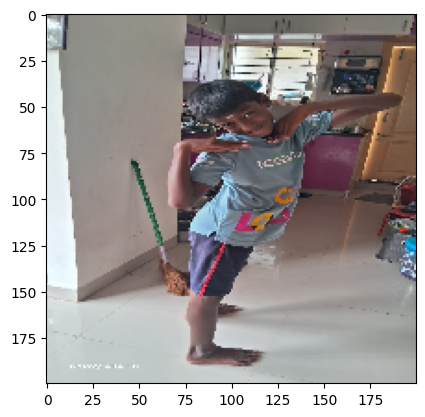

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 191ms/step
COW


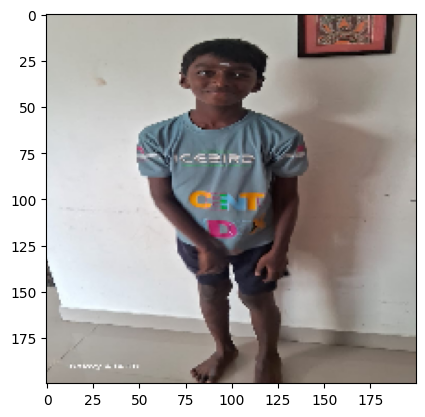

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step
COW


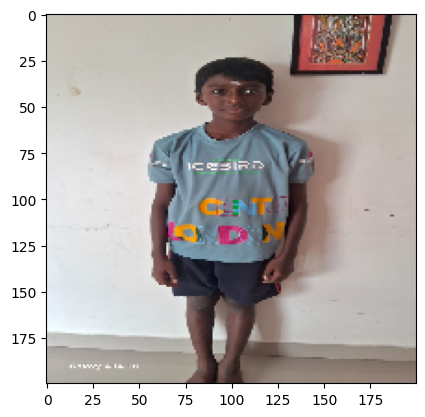

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step
COW


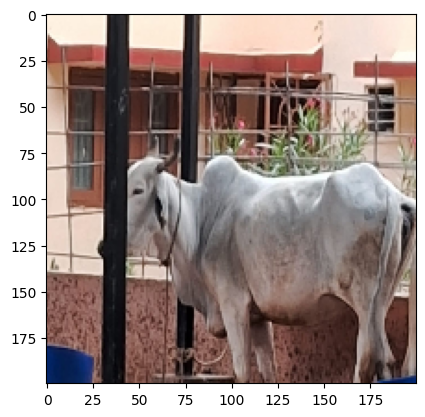

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step
COW


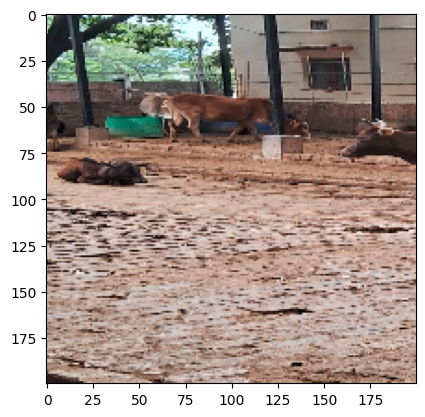

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step
COW


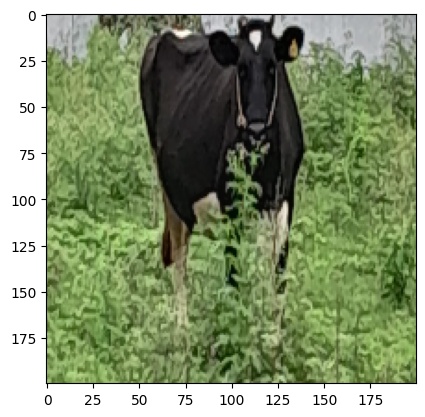

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
COW


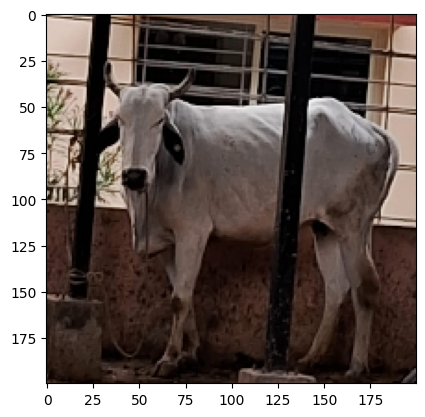

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
COW


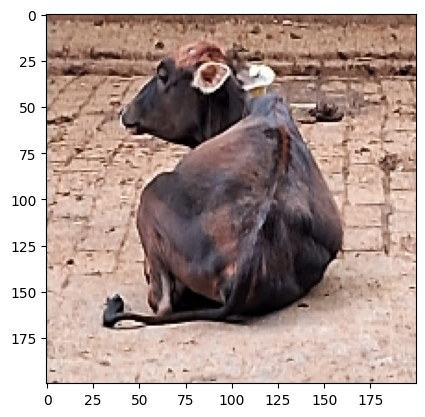

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step
COW


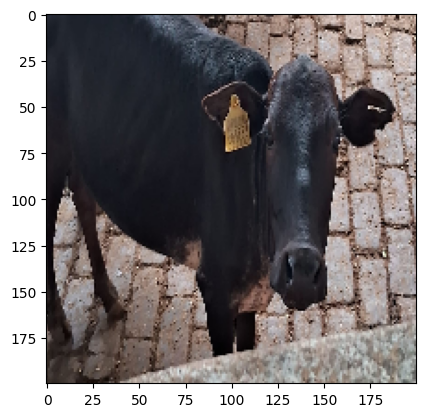

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 152ms/step
COW


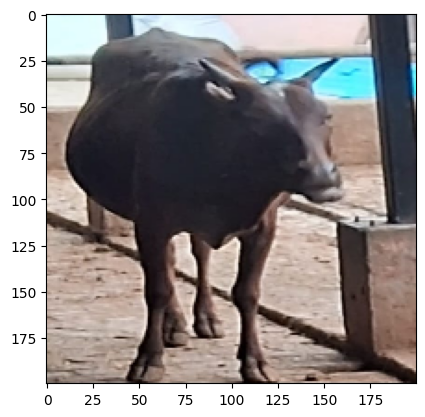

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
COW


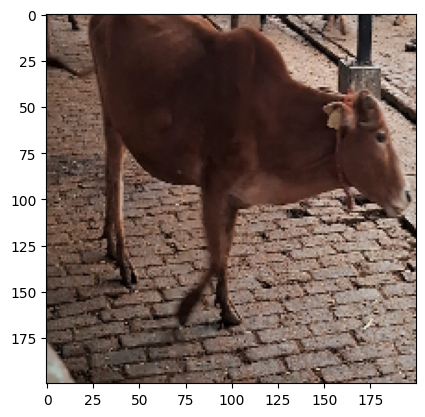

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step
COW


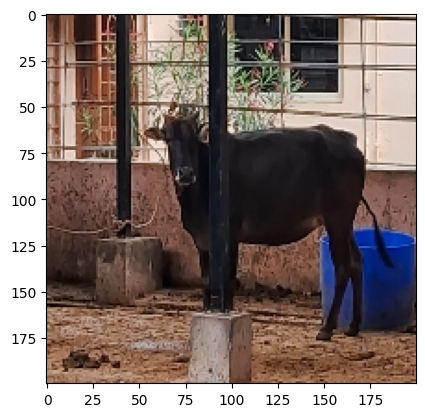

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
COW


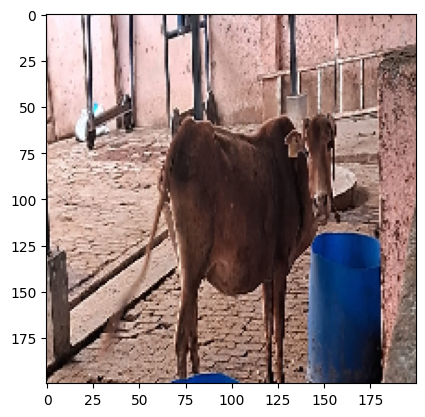

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
COW


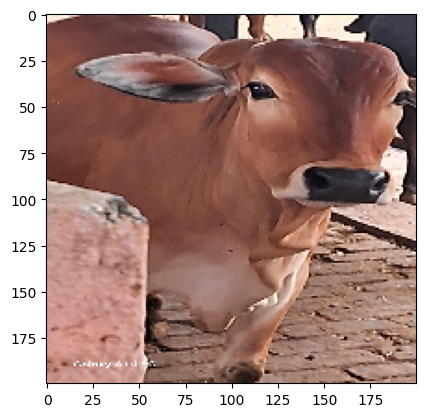

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
COW


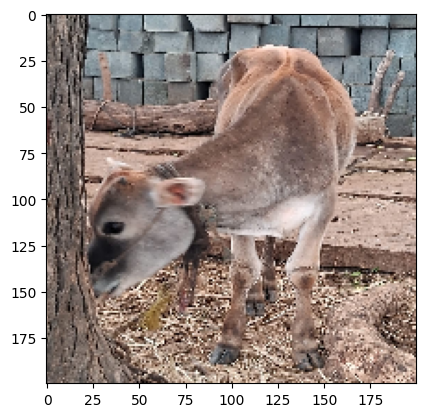

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
COW


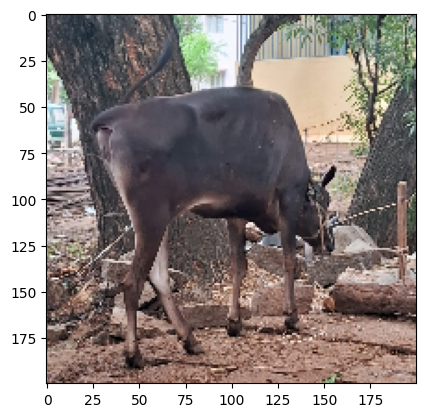

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
COW


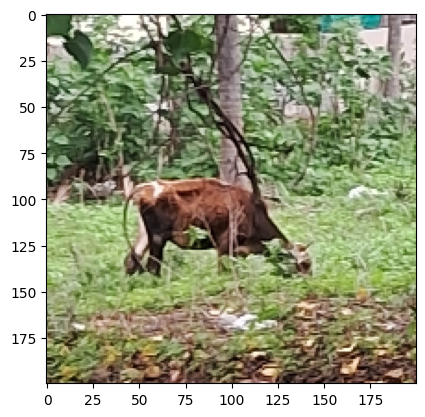

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
COW


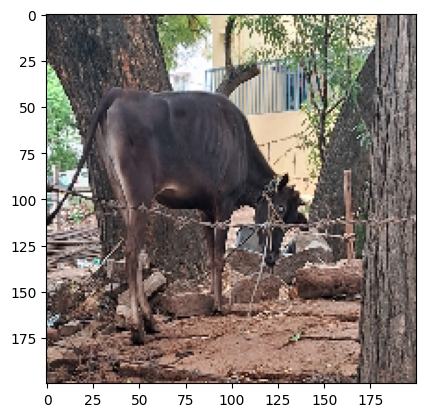

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step
COW


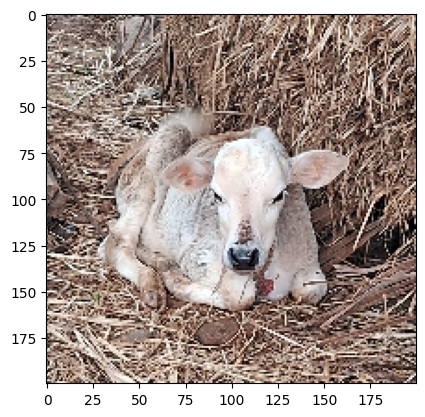

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
COW


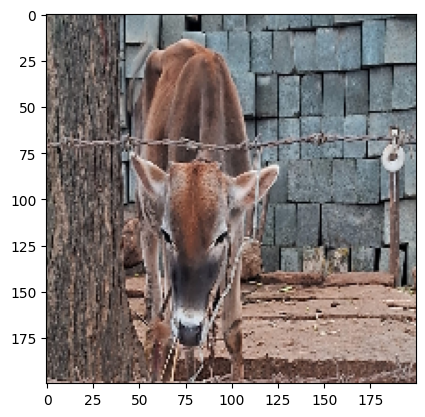

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
COW


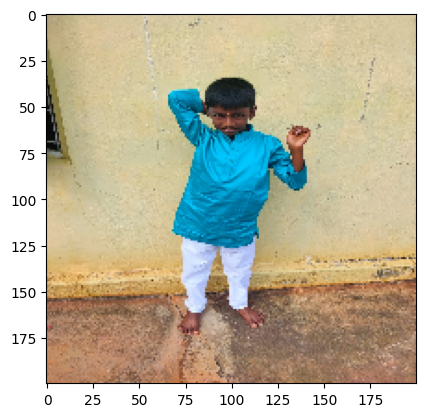

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
COW


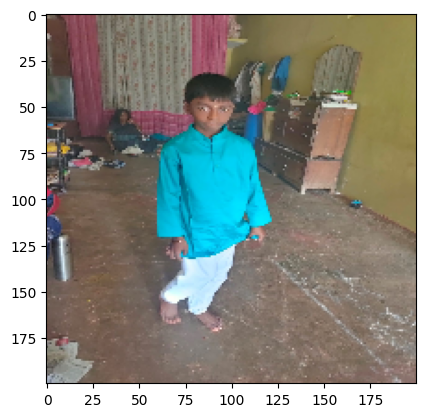

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
COW


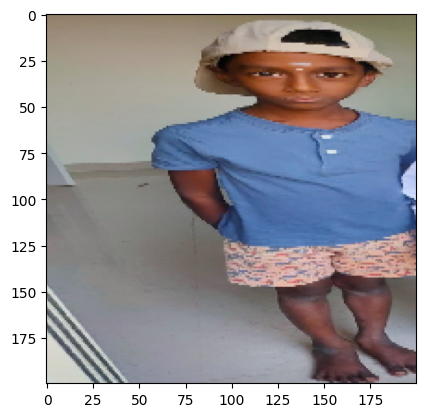

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
COW


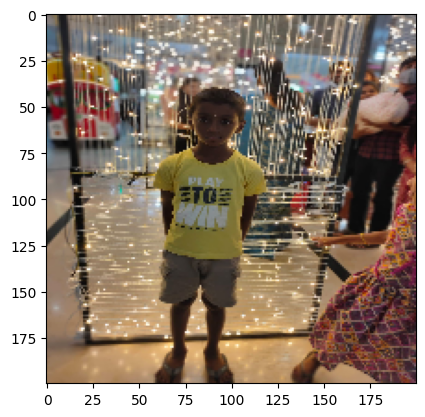

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
COW


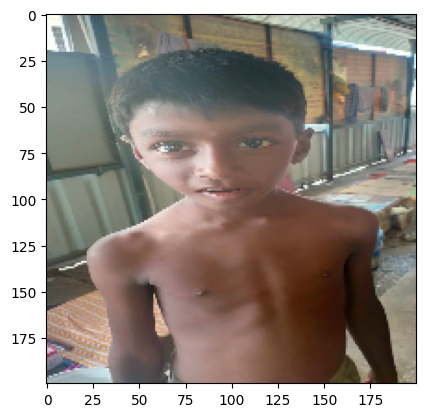

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step
COW


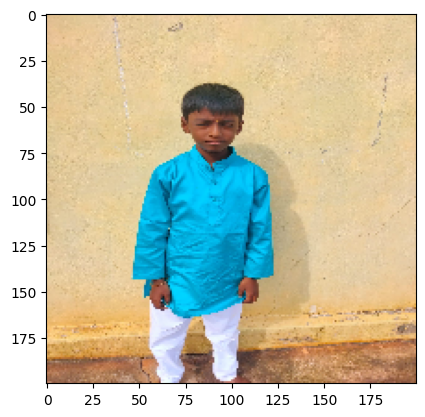

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step
COW


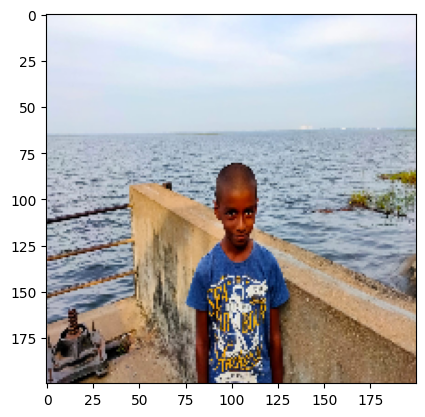

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
COW


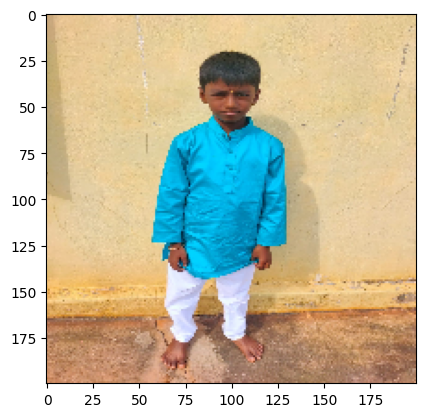

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
COW


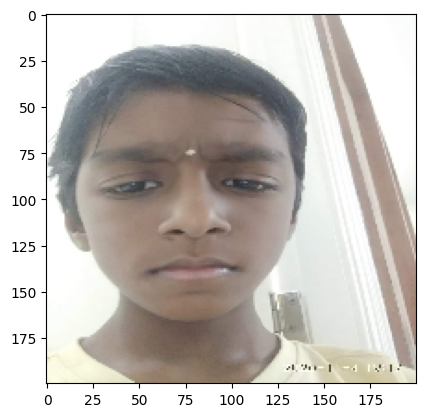

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
COW


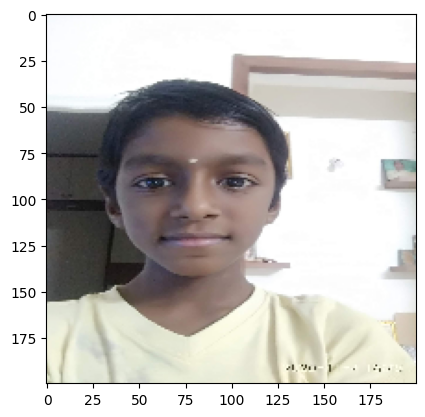

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step
COW


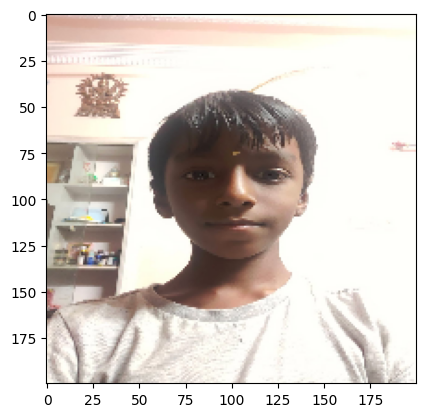

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
COW


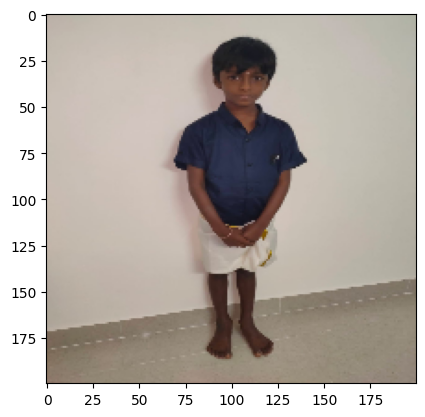

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
COW


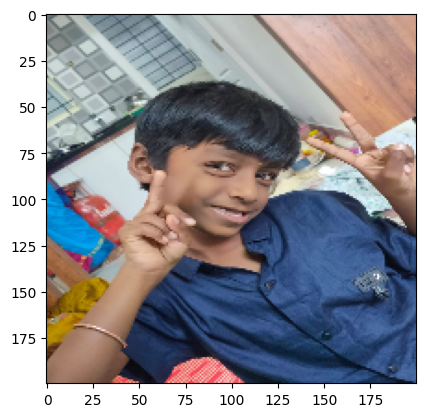

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
COW


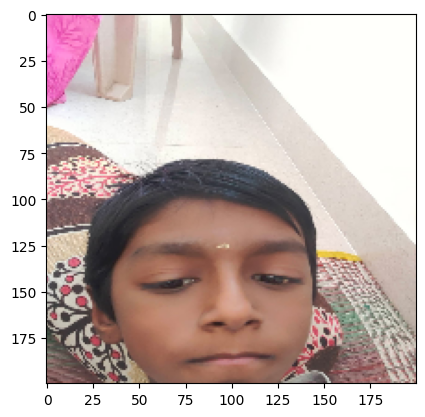

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
COW


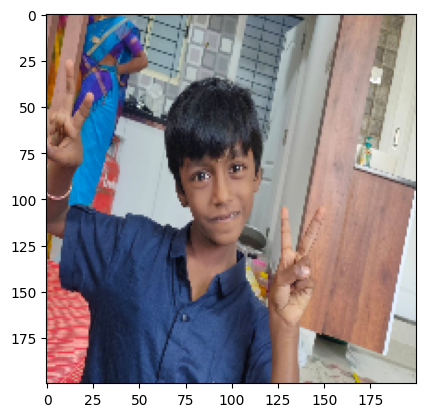

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
COW


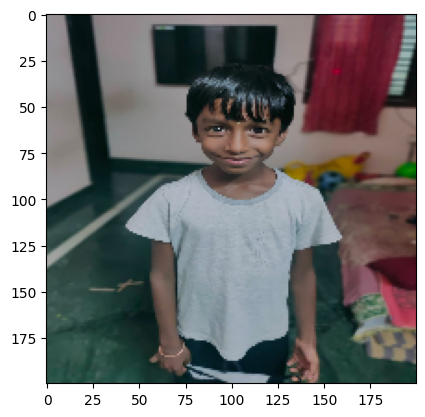

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
COW


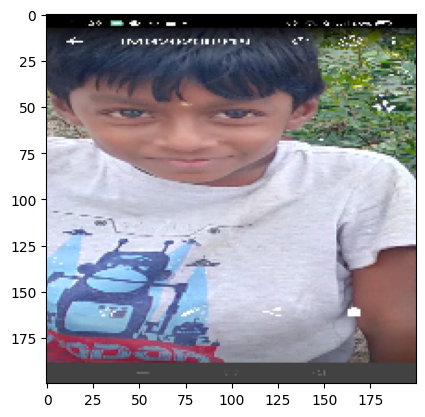

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
COW


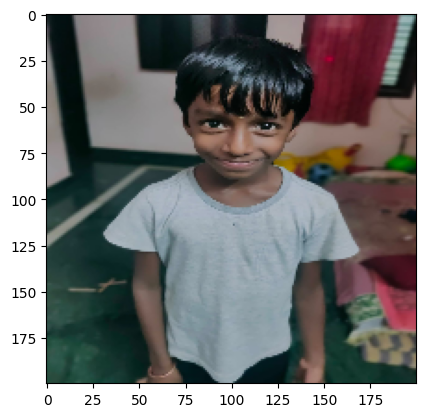

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
COW


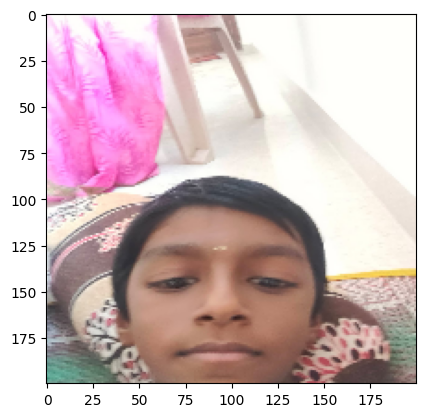

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
COW


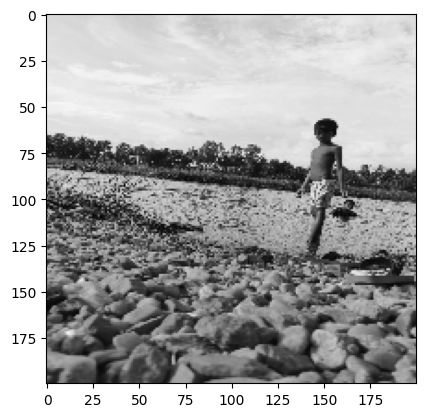

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
COW


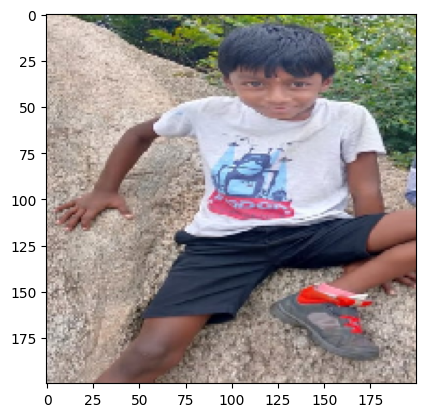

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
COW


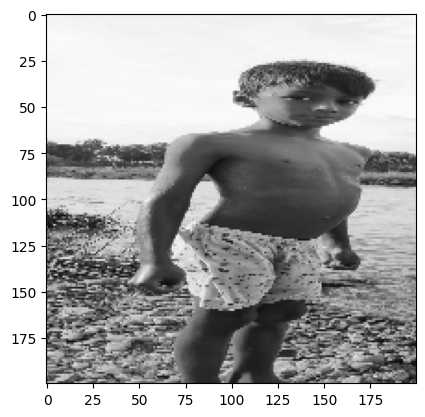

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
COW


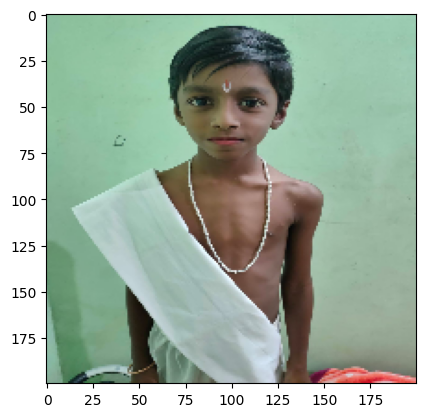

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
COW


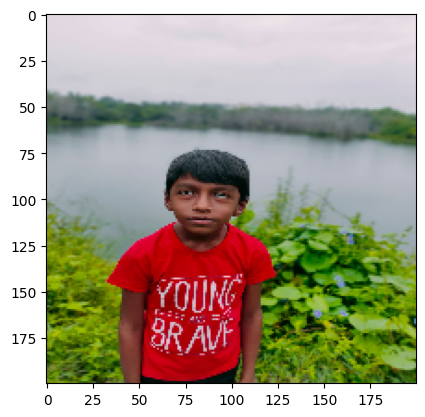

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step
COW


In [13]:
# Prediction on test images
dir_path = "C:/Users/Dell/Desktop/ML2/basedata2/test2"

for i in os.listdir(dir_path):
    img_path = os.path.join(dir_path, i)
    img = image.load_img(img_path, target_size=(200, 200))
    plt.imshow(img)
    plt.show()

    x = image.img_to_array(img)
    x = np.expand_dims(x, axis=0)
    images = np.vstack([x])
    val = model.predict(images)

    if val[0] < 0.5:
        print("COW")
    else:
        print("PATEL")

In [5]:
import tensorflow as tf
import os
import matplotlib.pyplot as plt
import numpy as np
from tensorflow.keras.preprocessing.image import ImageDataGenerator, load_img, img_to_array
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Conv2D, Flatten, Dropout, AveragePooling2D, BatchNormalization, Activation
from tensorflow.keras.optimizers import RMSprop
from tensorflow.keras.callbacks import ModelCheckpoint

# Image augmentation for training
train = ImageDataGenerator(
    rescale=1./255,
    rotation_range=25,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

# Only rescaling for validation
validation = ImageDataGenerator(rescale=1./255)

# Load training and validation datasets
train_dataset = train.flow_from_directory("C:/Users/Dell/Desktop/ML2/basedata2/train2/",
                                          target_size=(200, 200),
                                          batch_size=16,
                                          class_mode="binary",
                                          shuffle=True)

validation_dataset = validation.flow_from_directory("C:/Users/Dell/Desktop/ML2/basedata2/val2/",
                                                    target_size=(200, 200),
                                                    batch_size=16,
                                                    class_mode="binary",
                                                    shuffle=False)

# Swish activation function
def swish(x):
    return x * tf.nn.sigmoid(x)

# Model definition
model = Sequential([
    Conv2D(16, (3, 3), padding='same', input_shape=(200, 200, 3)),
    Activation(swish),
    BatchNormalization(),
    AveragePooling2D(2, 2),

    Conv2D(32, (3, 3), padding='same'),
    Activation(swish),
    BatchNormalization(),
    AveragePooling2D(2, 2),

    Conv2D(64, (3, 3), padding='same'),
    Activation(swish),
    BatchNormalization(),
    AveragePooling2D(2, 2),

    Conv2D(128, (3, 3), padding='same'),
    Activation(swish),
    BatchNormalization(),
    AveragePooling2D(2, 2),

    Flatten(),
    Dense(512),
    Activation(swish),
    Dropout(0.4),  # Slightly increased for better regularization
    Dense(1, activation="sigmoid")
])

# Compile the model
model.compile(
    loss="binary_crossentropy",
    optimizer=RMSprop(learning_rate=0.0003),  # Lower learning rate to help model distinguish better
    metrics=["accuracy"]
)

# Model checkpointing (best model will still be saved)
checkpoint = ModelCheckpoint("best_model.h5", monitor='val_loss', save_best_only=True)

# Train the model for full 50 epochs
model_fit = model.fit(
    train_dataset,
    epochs=50,
    validation_data=validation_dataset,
    callbacks=[checkpoint]
)

# Load best weights after training
model.load_weights("best_model.h5")


Found 708 images belonging to 2 classes.
Found 389 images belonging to 2 classes.
Epoch 1/50
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.7022 - loss: 2.0270

45/45 ━━━━━━━━━━━━━━━━━━━━ 98s 2s/step - accuracy: 0.7034 - loss: 2.0188 - val_accuracy: 0.2853 - val_loss: 1.1016
Epoch 2/50
45/45 ━━━━━━━━━━━━━━━━━━━━ 93s 2s/step - accuracy: 0.8290 - loss: 0.8665 - val_accuracy: 0.2853 - val_loss: 1.1999
Epoch 3/50
45/45 ━━━━━━━━━━━━━━━━━━━━ 96s 2s/step - accuracy: 0.8700 - loss: 0.7625 - val_accuracy: 0.2853 - val_loss: 1.3473
Epoch 4/50
45/45 ━━━━━━━━━━━━━━━━━━━━ 82s 2s/step - accuracy: 0.8224 - loss: 0.9346 - val_accuracy: 0.2853 - val_loss: 1.8256
Epoch 5/50
45/45 ━━━━━━━━━━━━━━━━━━━━ 85s 2s/step - accuracy: 0.8477 - loss: 0.8022 - val_accuracy: 0.2853 - val_loss: 2.5671
Epoch 6/50
45/45 ━━━━━━━━━━━━━━━━━━━━ 84s 2s/step - accuracy: 0.8579 - loss: 0.4940 - val_accuracy: 0.2853 - val_loss: 4.7516
Epoch 7/50
45/45 ━━━━━━━━━━━━━━━━━━━━ 84s 2s/step - accuracy: 0.9064 - loss: 0.3890 - val_accuracy: 0.4961 - val_loss: 1.2565
Epoch 8/50
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.8911 - loss: 0.3573

45/45 ━━━━━━━━━━━━━━━━━━━━ 90s 2s/step - accuracy: 0.8909 - loss: 0.3586 - val_accuracy: 0.6941 - val_loss: 1.0449
Epoch 9/50
45/45 ━━━━━━━━━━━━━━━━━━━━ 86s 2s/step - accuracy: 0.9132 - loss: 0.2543 - val_accuracy: 0.5373 - val_loss: 2.9302
Epoch 10/50
45/45 ━━━━━━━━━━━━━━━━━━━━ 86s 2s/step - accuracy: 0.8882 - loss: 0.3539 - val_accuracy: 0.5784 - val_loss: 1.4919
Epoch 11/50
45/45 ━━━━━━━━━━━━━━━━━━━━ 87s 2s/step - accuracy: 0.9029 - loss: 0.2792 - val_accuracy: 0.6272 - val_loss: 1.3224
Epoch 12/50
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.8977 - loss: 0.3579

45/45 ━━━━━━━━━━━━━━━━━━━━ 84s 2s/step - accuracy: 0.8976 - loss: 0.3572 - val_accuracy: 0.7943 - val_loss: 0.7753
Epoch 13/50
45/45 ━━━━━━━━━━━━━━━━━━━━ 88s 2s/step - accuracy: 0.9077 - loss: 0.3223 - val_accuracy: 0.7532 - val_loss: 1.1270
Epoch 14/50
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.9180 - loss: 0.2395

45/45 ━━━━━━━━━━━━━━━━━━━━ 83s 2s/step - accuracy: 0.9181 - loss: 0.2404 - val_accuracy: 0.8329 - val_loss: 0.5969
Epoch 15/50
45/45 ━━━━━━━━━━━━━━━━━━━━ 83s 2s/step - accuracy: 0.9368 - loss: 0.1778 - val_accuracy: 0.8715 - val_loss: 0.9068
Epoch 16/50
45/45 ━━━━━━━━━━━━━━━━━━━━ 82s 2s/step - accuracy: 0.9497 - loss: 0.1647 - val_accuracy: 0.8895 - val_loss: 0.9383
Epoch 17/50
45/45 ━━━━━━━━━━━━━━━━━━━━ 4120s 94s/step - accuracy: 0.9442 - loss: 0.1776 - val_accuracy: 0.8817 - val_loss: 1.0760
Epoch 18/50
45/45 ━━━━━━━━━━━━━━━━━━━━ 2233s 51s/step - accuracy: 0.9300 - loss: 0.1717 - val_accuracy: 0.8740 - val_loss: 1.7375
Epoch 19/50
45/45 ━━━━━━━━━━━━━━━━━━━━ 71s 2s/step - accuracy: 0.9399 - loss: 0.2291 - val_accuracy: 0.8792 - val_loss: 1.2025
Epoch 20/50
45/45 ━━━━━━━━━━━━━━━━━━━━ 84s 2s/step - accuracy: 0.9539 - loss: 0.1533 - val_accuracy: 0.9049 - val_loss: 0.7493
Epoch 21/50
45/45 ━━━━━━━━━━━━━━━━━━━━ 80s 2s/step - accuracy: 0.9374 - loss: 0.2396 - val_accuracy: 0.9280 - val_los

45/45 ━━━━━━━━━━━━━━━━━━━━ 133s 2s/step - accuracy: 0.9527 - loss: 0.1598 - val_accuracy: 0.9332 - val_loss: 0.4476
Epoch 27/50
45/45 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.9488 - loss: 0.1239

45/45 ━━━━━━━━━━━━━━━━━━━━ 84s 2s/step - accuracy: 0.9488 - loss: 0.1242 - val_accuracy: 0.9229 - val_loss: 0.4456
Epoch 28/50
45/45 ━━━━━━━━━━━━━━━━━━━━ 81s 2s/step - accuracy: 0.9370 - loss: 0.2030 - val_accuracy: 0.9332 - val_loss: 0.5999
Epoch 29/50
45/45 ━━━━━━━━━━━━━━━━━━━━ 79s 2s/step - accuracy: 0.9452 - loss: 0.1779 - val_accuracy: 0.9434 - val_loss: 0.6406
Epoch 30/50
45/45 ━━━━━━━━━━━━━━━━━━━━ 80s 2s/step - accuracy: 0.9646 - loss: 0.1135 - val_accuracy: 0.9280 - val_loss: 0.5865
Epoch 31/50
45/45 ━━━━━━━━━━━━━━━━━━━━ 84s 2s/step - accuracy: 0.9431 - loss: 0.2569 - val_accuracy: 0.8997 - val_loss: 0.8958
Epoch 32/50
45/45 ━━━━━━━━━━━━━━━━━━━━ 84s 2s/step - accuracy: 0.9586 - loss: 0.1341 - val_accuracy: 0.9280 - val_loss: 0.9105
Epoch 33/50
45/45 ━━━━━━━━━━━━━━━━━━━━ 90s 2s/step - accuracy: 0.9515 - loss: 0.1907 - val_accuracy: 0.9203 - val_loss: 0.8985
Epoch 34/50
45/45 ━━━━━━━━━━━━━━━━━━━━ 84s 2s/step - accuracy: 0.9754 - loss: 0.0994 - val_accuracy: 0.9254 - val_loss: 0.9

45/45 ━━━━━━━━━━━━━━━━━━━━ 80s 2s/step - accuracy: 0.9618 - loss: 0.1139 - val_accuracy: 0.9460 - val_loss: 0.4127
Epoch 50/50
45/45 ━━━━━━━━━━━━━━━━━━━━ 73s 2s/step - accuracy: 0.9690 - loss: 0.1035 - val_accuracy: 0.9460 - val_loss: 0.5295


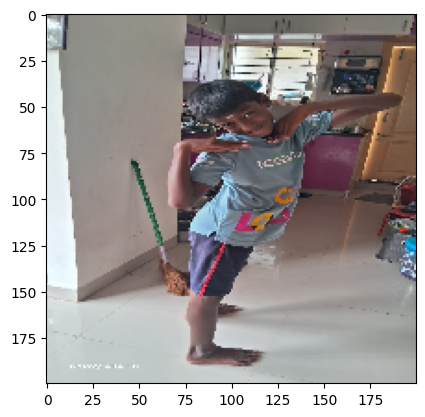

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 512ms/step
PATEL


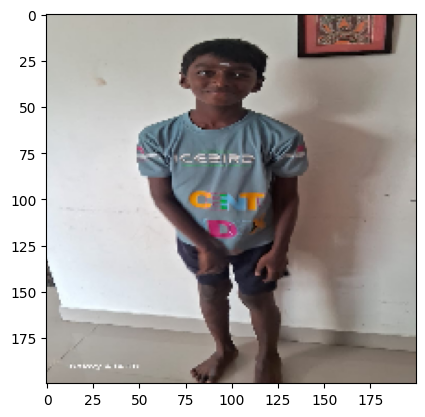

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step
PATEL


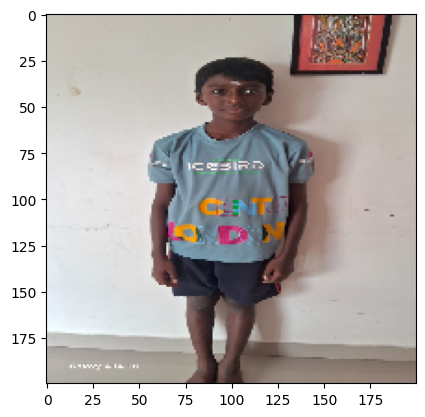

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step
PATEL


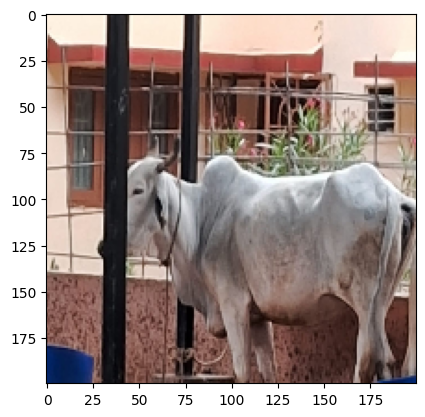

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step
COW


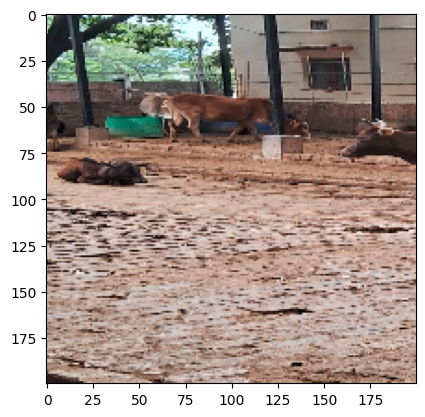

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step
COW


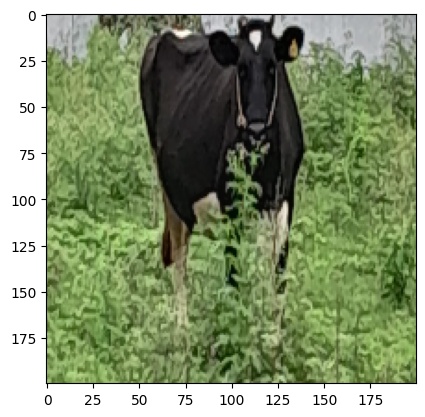

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step
COW


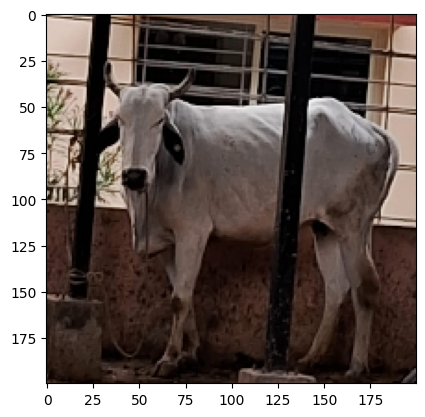

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step
COW


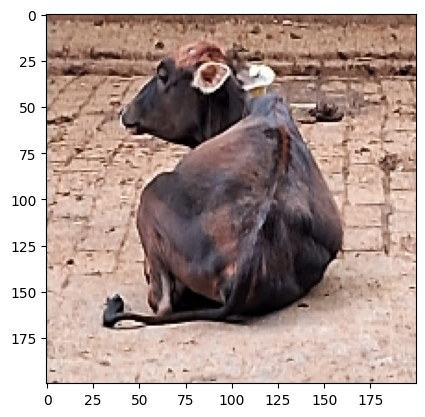

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step
PATEL


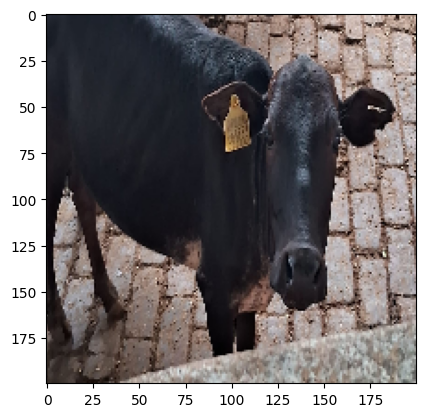

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step
COW


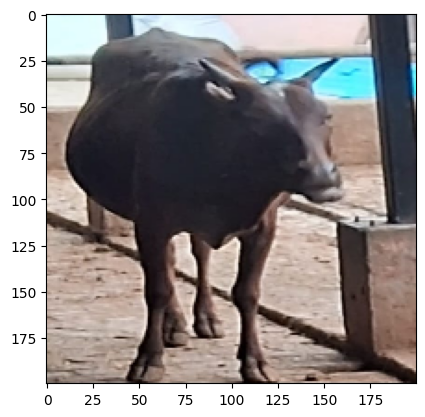

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
COW


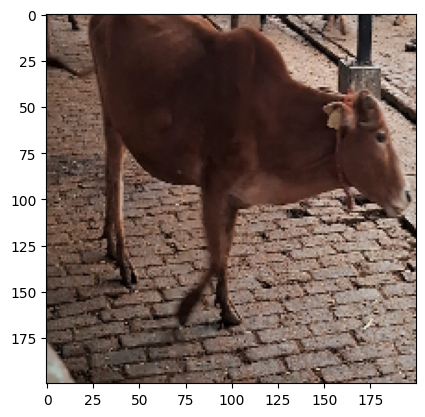

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 117ms/step
COW


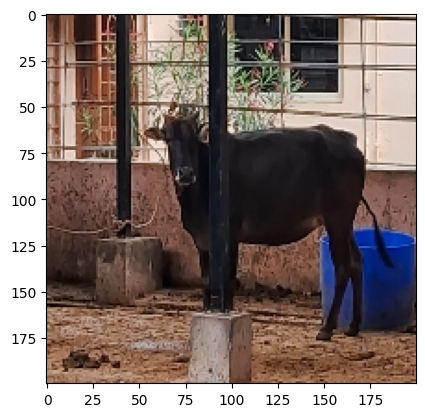

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
COW


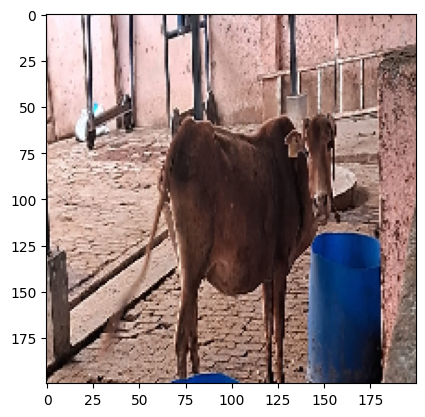

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
COW


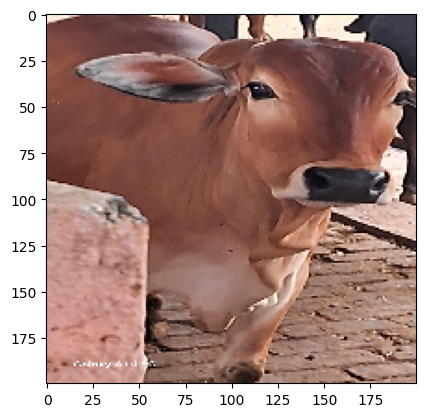

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step
COW


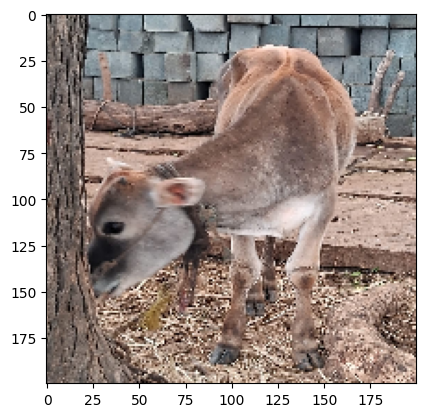

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step
COW


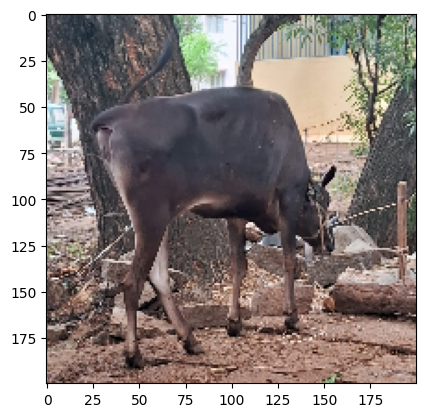

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step
COW


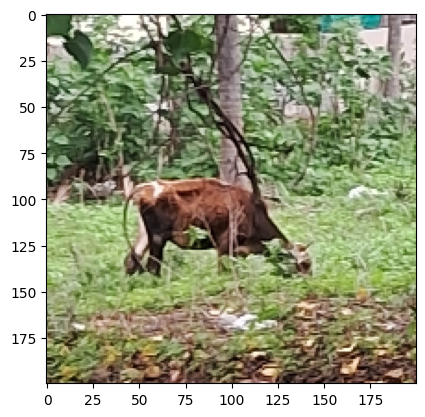

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step
COW


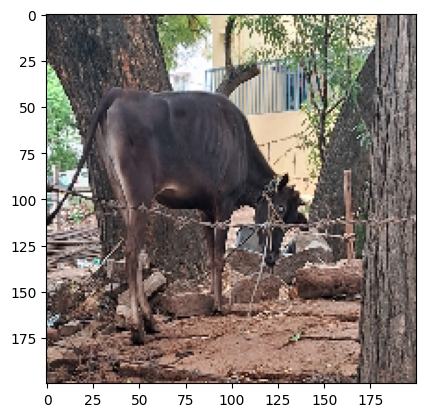

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step
COW


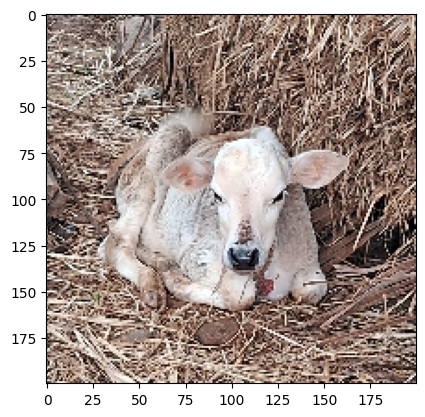

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step
COW


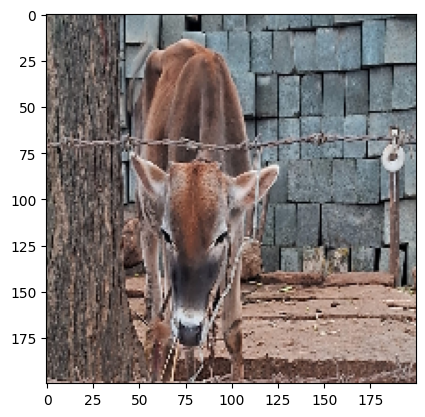

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step
COW


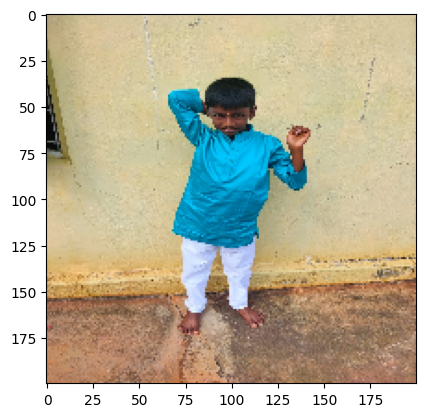

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step
PATEL


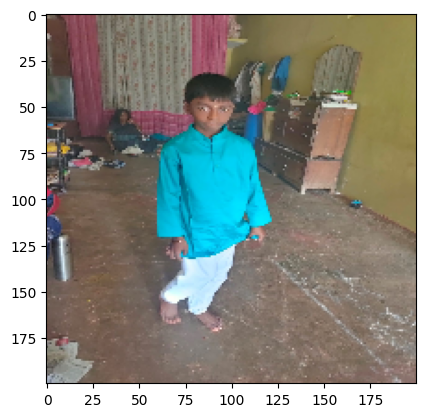

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step
PATEL


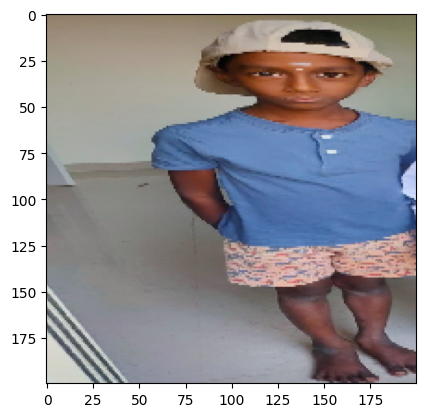

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step
PATEL


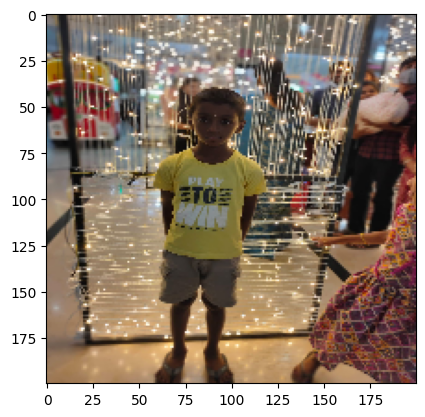

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step
COW


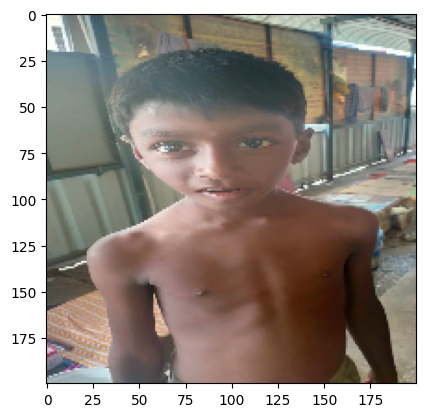

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 78ms/step
PATEL


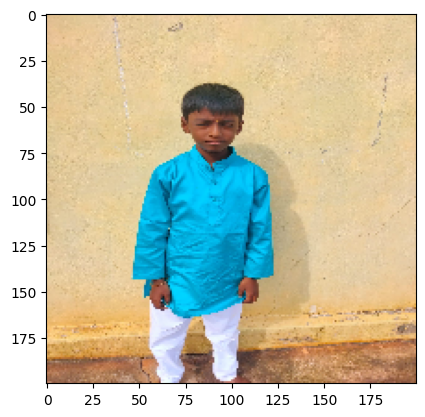

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step
PATEL


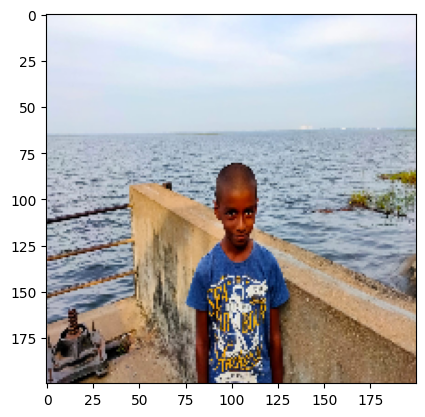

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step
PATEL


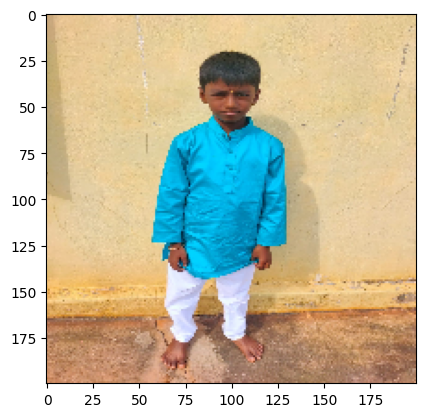

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
PATEL


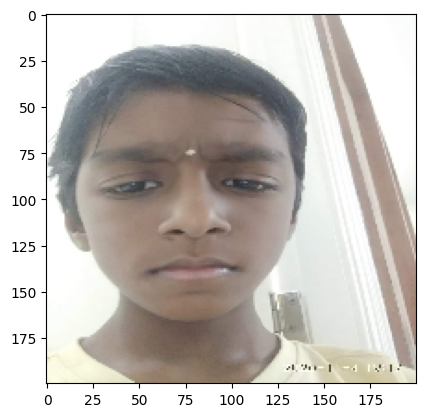

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step
PATEL


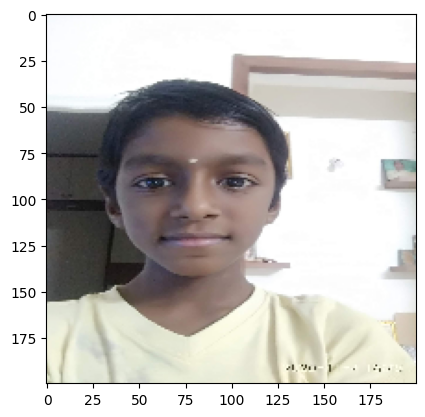

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
PATEL


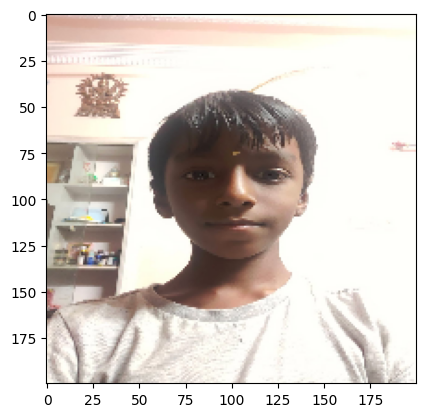

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step
COW


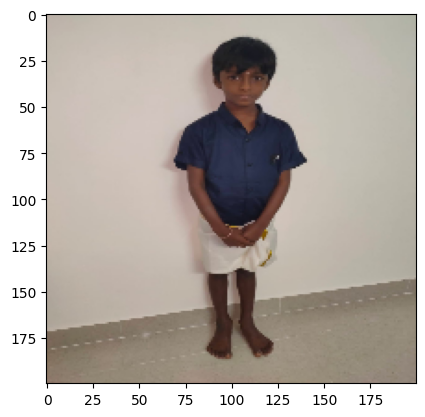

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step
PATEL


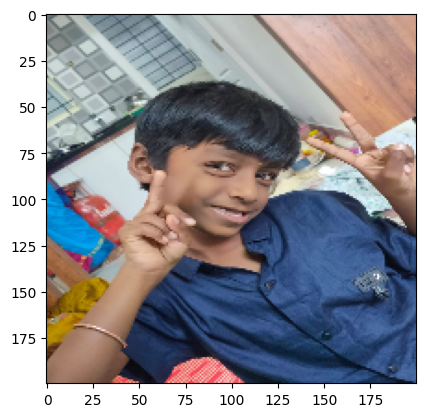

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step
PATEL


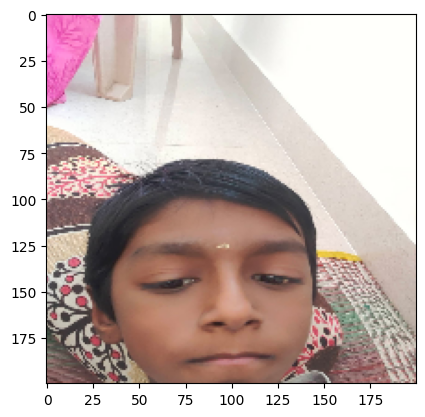

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step
PATEL


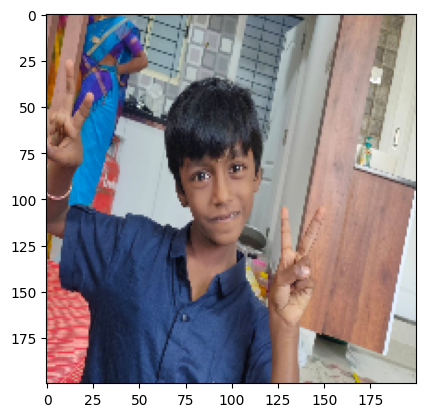

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step
PATEL


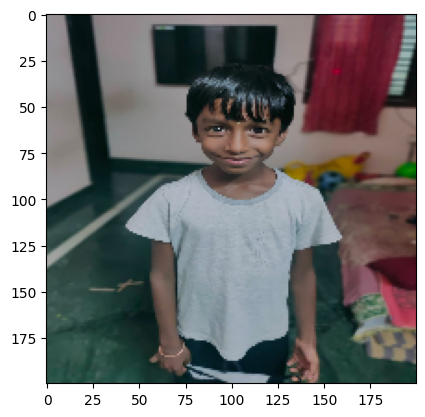

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step
PATEL


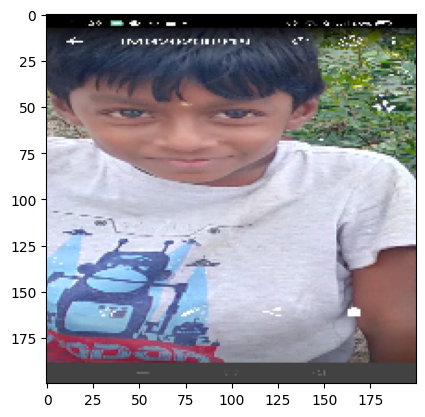

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step
PATEL


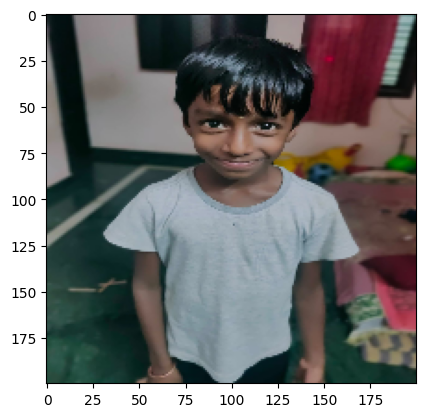

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step
PATEL


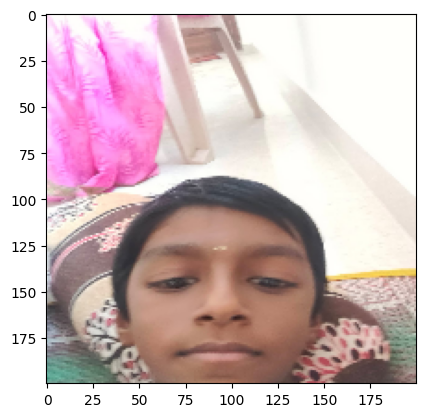

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step
PATEL


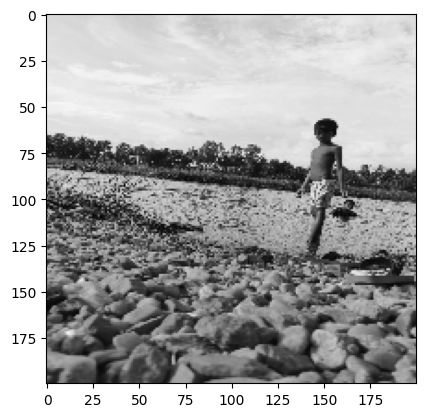

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step
PATEL


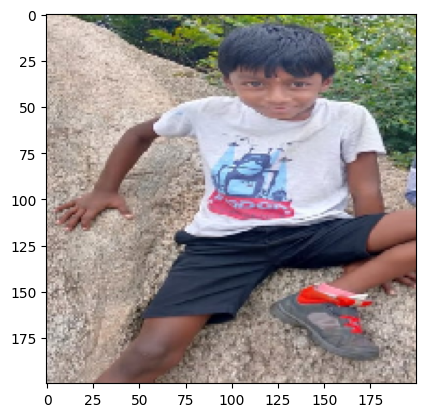

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step
PATEL


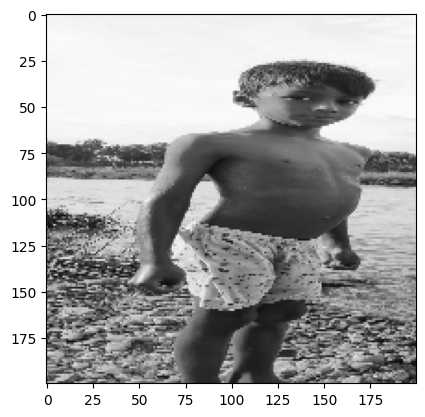

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step
PATEL


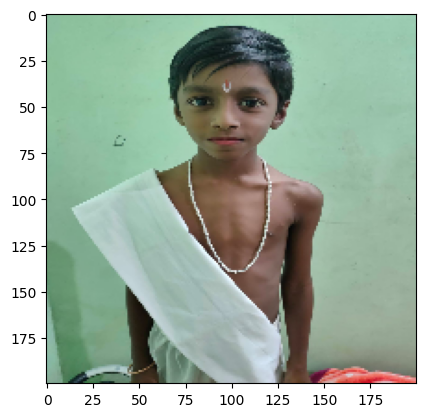

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
COW


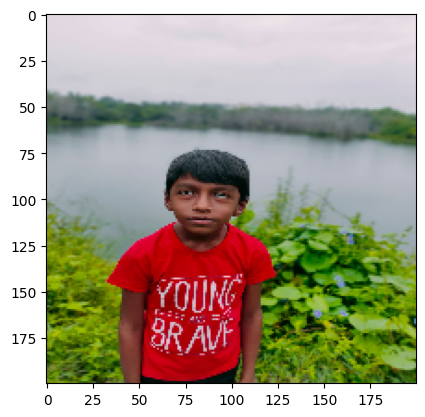

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step
PATEL


In [6]:
# Prediction
dir_path = "C:/Users/Dell/Desktop/ML2/basedata2/test2"

for i in os.listdir(dir_path):
    img_path = os.path.join(dir_path, i)
    img = load_img(img_path, target_size=(200, 200))
    plt.imshow(img)
    plt.show()

    x = img_to_array(img)
    x = np.expand_dims(x, axis=0)
    x /= 255.0

    prediction = model.predict(x)

    if prediction[0] < 0.5:
        print("COW")
    else:
        print("PATEL")